# Lab 4: Explainability of Azure ML models

<img src='https://github.com/retkowsky/images/blob/master/AzureMLservicebanniere.png?raw=true'>

> https://docs.microsoft.com/en-us/azure/machine-learning/how-to-machine-learning-interpretability

## 1. Informations

In [1]:
import sys
sys.version

'3.6.9 |Anaconda, Inc.| (default, Jul 30 2019, 19:07:31) \n[GCC 7.3.0]'

In [2]:
import datetime
maintenant = datetime.datetime.now()
print('Date:', maintenant)

Date: 2021-02-01 14:18:34.664233


In [3]:
import azureml.core
print("This Jupyter notebook was made using Azure ML 1.21.0")
print("You are using Azure ML", azureml.core.VERSION)

This Jupyter notebook was made using Azure ML 1.21.0
You are using Azure ML 1.21.0


## Workspace

In [4]:
from azureml.core import Workspace
ws = Workspace.from_config()

## 2. Let's build a ML model

In [5]:
from azureml.core import Experiment
experiment_name = 'Lab4-Explainability'

experiment = Experiment(workspace=ws, name=experiment_name)
run = experiment.start_logging(snapshot_directory=None)

In [6]:
import os
import pandas as pd

outdirname = 'dataset.6.21.19'
try:
    from urllib import urlretrieve
except ImportError:
    from urllib.request import urlretrieve
import zipfile
zipfilename = outdirname + '.zip'
urlretrieve('https://publictestdatasets.blob.core.windows.net/data/' + zipfilename, zipfilename)
with zipfile.ZipFile(zipfilename, 'r') as unzip:
    unzip.extractall('.')
attritionData = pd.read_csv('./WA_Fn-UseC_-HR-Employee-Attrition.csv')

In [7]:
attritionData.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


In [8]:
try:
    import pandas_profiling
    print("You are using Pandas Profiling:", pandas_profiling.__version__)
except ImportError:
    %pip install pandas_profiling

import numpy as np
attritionData.profile_report()

You are using Pandas Profiling: 2.10.0


In [9]:
attritionData.describe()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
count,1470.000000,1470.000000,1470.000000,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,...,1470.000000,1470.0,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000,1470.000000
mean,36.923810,802.485714,9.192517,2.912925,1.0,1024.865306,2.721769,65.891156,2.729932,2.063946,...,2.712245,80.0,0.793878,11.279592,2.799320,2.761224,7.008163,4.229252,2.187755,4.123129
std,9.135373,403.509100,8.106864,1.024165,0.0,602.024335,1.093082,20.329428,0.711561,1.106940,...,1.081209,0.0,0.852077,7.780782,1.289271,0.706476,6.126525,3.623137,3.222430,3.568136
min,18.000000,102.000000,1.000000,1.000000,1.0,1.000000,1.000000,30.000000,1.000000,1.000000,...,1.000000,80.0,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,30.000000,465.000000,2.000000,2.000000,1.0,491.250000,2.000000,48.000000,2.000000,1.000000,...,2.000000,80.0,0.000000,6.000000,2.000000,2.000000,3.000000,2.000000,0.000000,2.000000
50%,36.000000,802.000000,7.000000,3.000000,1.0,1020.500000,3.000000,66.000000,3.000000,2.000000,...,3.000000,80.0,1.000000,10.000000,3.000000,3.000000,5.000000,3.000000,1.000000,3.000000
75%,43.000000,1157.000000,14.000000,4.000000,1.0,1555.750000,4.000000,83.750000,3.000000,3.000000,...,4.000000,80.0,1.000000,15.000000,3.000000,3.000000,9.000000,7.000000,3.000000,7.000000
max,60.000000,1499.000000,29.000000,5.000000,1.0,2068.000000,4.000000,100.000000,4.000000,5.000000,...,4.000000,80.0,3.000000,40.000000,6.000000,4.000000,40.000000,18.000000,15.000000,17.000000


In [10]:
attritionData.Attrition.value_counts()

No     1233
Yes     237
Name: Attrition, dtype: int64

In [11]:
attritionData.Attrition.value_counts(normalize=True)

No     0.838776
Yes    0.161224
Name: Attrition, dtype: float64

In [12]:
attritionData.corr()

,Age,DailyRate,DistanceFromHome,Education,EmployeeCount,EmployeeNumber,EnvironmentSatisfaction,HourlyRate,JobInvolvement,JobLevel,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
Age,1.000000,0.010661,-0.001686,0.208034,NaN,-0.010145,0.010146,0.024287,0.029820,0.509604,...,0.053535,NaN,0.037510,0.680381,-0.019621,-0.021490,0.311309,0.212901,0.216513,0.202089
DailyRate,0.010661,1.000000,-0.004985,-0.016806,NaN,-0.050990,0.018355,0.023381,0.046135,0.002966,...,0.007846,NaN,0.042143,0.014515,0.002453,-0.037848,-0.034055,0.009932,-0.033229,-0.026363
DistanceFromHome,-0.001686,-0.004985,1.000000,0.021042,NaN,0.032916,-0.016075,0.031131,0.008783,0.005303,...,0.006557,NaN,0.044872,0.004628,-0.036942,-0.026556,0.009508,0.018845,0.010029,0.014406
Education,0.208034,-0.016806,0.021042,1.000000,NaN,0.042070,-0.027128,0.016775,0.042438,0.101589,...,-0.009118,NaN,0.018422,0.148280,-0.025100,0.009819,0.069114,0.060236,0.054254,0.069065
EmployeeCount,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
EmployeeNumber,-0.010145,-0.050990,0.032916,0.042070,NaN,1.000000,0.017621,0.035179,-0.006888,-0.018519,...,-0.069861,NaN,0.062227,-0.014365,0.023603,0.010309,-0.011240,-0.008416,-0.009019,-0.009197
EnvironmentSatisfaction,0.010146,0.018355,-0.016075,-0.027128,NaN,0.017621,1.000000,-0.049857,-0.008278,0.001212,...,0.007665,NaN,0.003432,-0.002693,-0.019359,0.027627,0.001458,0.018007,0.016194,-0.004999
HourlyRate,0.024287,0.023381,0.031131,0.016775,NaN,0.035179,-0.049857,1.000000,0.042861,-0.027853,...,0.001330,NaN,0.050263,-0.002334,-0.008548,-0.004607,-0.019582,-0.024106,-0.026716,-0.020123
JobInvolvement,0.029820,0.046135,0.008783,0.042438,NaN,-0.006888,-0.008278,0.042861,1.000000,-0.012630,...,0.034297,NaN,0.021523,-0.005533,-0.015338,-0.014617,-0.021355,0.008717,-0.024184,0.025976
JobLevel,0.509604,0.002966,0.005303,0.101589,NaN,-0.018519,0.001212,-0.027853,-0.012630,1.000000,...,0.021642,NaN,0.013984,0.782208,-0.018191,0.037818,0.534739,0.389447,0.353885,0.375281


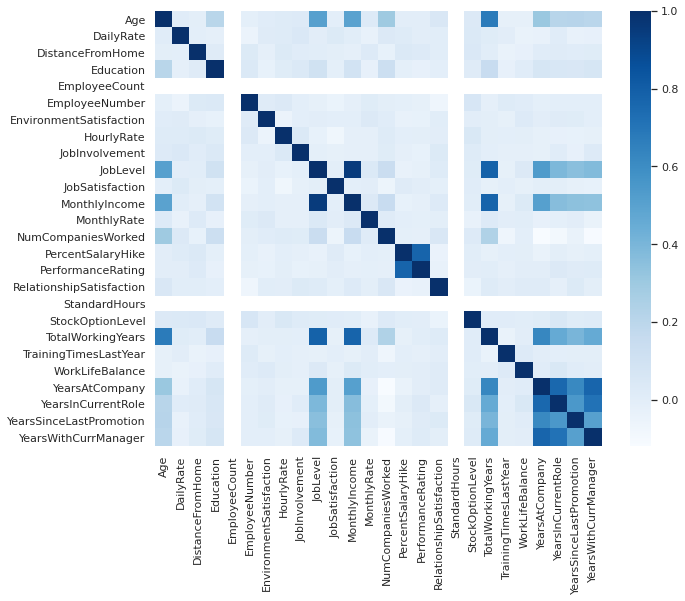

In [13]:
import seaborn as sb

sb.set(style='whitegrid', context='notebook', rc={'figure.figsize':(10, 8)})
dataplot=sb.heatmap(attritionData.corr(), cmap="Blues") 

In [14]:
from sklearn.model_selection import train_test_split
from sklearn.externals import joblib
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn_pandas import DataFrameMapper

from interpret.ext.blackbox import TabularExplainer

os.makedirs('./outputs', exist_ok=True)

# Dropping Employee count as all values are 1 and hence attrition is independent of this feature
attritionData = attritionData.drop(['EmployeeCount'], axis=1)
# Dropping Employee Number since it is merely an identifier
attritionData = attritionData.drop(['EmployeeNumber'], axis=1)
attritionData = attritionData.drop(['Over18'], axis=1)
# Since all values are 80
attritionData = attritionData.drop(['StandardHours'], axis=1)

# Converting target variables from string to numerical values
target_map = {'Yes': 1, 'No': 0}
attritionData["Attrition_numerical"] = attritionData["Attrition"].apply(lambda x: target_map[x])
target = attritionData["Attrition_numerical"]

attritionXData = attritionData.drop(['Attrition_numerical', 'Attrition'], axis=1)

# Creating dummy columns for each categorical feature
categorical = []
for col, value in attritionXData.iteritems():
    if value.dtype == 'object':
        categorical.append(col)

# Store the numerical columns in a list numerical
numerical = attritionXData.columns.difference(categorical)

numeric_transformations = [([f], Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())])) for f in numerical]

categorical_transformations = [([f], OneHotEncoder(handle_unknown='ignore', sparse=False)) for f in categorical]

transformations = numeric_transformations + categorical_transformations

# Append classifier to preprocessing pipeline.
# Now we have a full prediction pipeline.
clf = Pipeline(steps=[('preprocessor', DataFrameMapper(transformations)),
                      ('classifier', RandomForestClassifier())])

# Split data into train and test
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(attritionXData,
                                                    target,
                                                    test_size = 0.2,
                                                    random_state=0,
                                                    stratify=target)

# preprocess the data and fit the classification model
clf.fit(x_train, y_train)
model = clf.steps[-1][1]

model_file_name = 'log_reg.pkl'

# save model in the outputs folder so it automatically get uploaded
with open(model_file_name, 'wb') as file:
    joblib.dump(value=clf, filename=os.path.join('./outputs/',
                                                 model_file_name))

/anaconda/envs/azureml_py36/lib/python3.6/site-packages/sklearn/externals/joblib/__init__.py:15: FutureWarning: sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.
  warnings.warn(msg, category=FutureWarning)


Could not import LIME, required for LIMEExplainer


## 3. Azure ML explainability

In [15]:
# Explain predictions on your local machine
tabular_explainer = TabularExplainer(model, 
                                     initialization_examples=x_train, 
                                     features=attritionXData.columns, 
                                     classes=["Not leaving", "leaving"], 
                                     transformations=transformations)

# Explain overall model predictions (global explanation)
# Passing in test dataset for evaluation examples - note it must be a representative sample of the original data
# x_train can be passed as well, but with more examples explanations it will
# take longer although they may be more accurate
global_explanation = tabular_explainer.explain_global(x_test)

Setting feature_perturbation = "tree_path_dependent" because no background data was given.
Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.


In [16]:
from azureml.interpret.scoring.scoring_explainer import TreeScoringExplainer, save
# ScoringExplainer
scoring_explainer = TreeScoringExplainer(tabular_explainer)
# Pickle scoring explainer locally
save(scoring_explainer, exist_ok=True)

# Register original model
run.upload_file('original_model.pkl', os.path.join('./outputs/', model_file_name))
original_model = run.register_model(model_name='local_deploy_model', 
                                    model_path='original_model.pkl')

# Register scoring explainer
run.upload_file('IBM_attrition_explainer.pkl', 'scoring_explainer.pkl')
scoring_explainer_model = run.register_model(model_name='IBM_attrition_explainer', model_path='IBM_attrition_explainer.pkl')

## Viewing the results

In [17]:
from interpret_community.widget import ExplanationDashboard

In [18]:
ExplanationDashboard(global_explanation, clf, datasetX=x_test)

> You can open now the **Lab5 notebook.**

<img src="https://github.com/retkowsky/images/blob/master/Powered-by-MS-Azure-logo-v2.png?raw=true" height="300" width="300">